In [16]:
import os
import os.path as osp
import numpy as np
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms

import kagglehub
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from torchvision.models import resnet50

from tqdm import tqdm  # For progress bar


# Define the colour map from the provided colour map file
colour_map = {
    (0, 0, 0): 0,           # void
    (108, 64, 20): 1,       # dirt
    (255, 229, 204): 2,     # sand
    (0, 102, 0): 3,         # grass
    (0, 255, 0): 4,         # tree
    (0, 153, 153): 5,       # pole
    (0, 128, 255): 6,       # water
    (0, 0, 255): 7,         # sky
    (255, 255, 0): 8,       # vehicle
    (255, 0, 127): 9,       # container/generic-object
    (64, 64, 64): 10,       # asphalt
    (255, 128, 0): 11,      # gravel
    (255, 0, 0): 12,        # building
    (153, 76, 0): 13,       # mulch
    (102, 102, 0): 14,      # rock-bed
    (102, 0, 0): 15,        # log
    (0, 255, 128): 16,      # bicycle
    (204, 153, 255): 17,    # person
    (102, 0, 204): 18,      # fence
    (255, 153, 204): 19,    # bush
    (0, 102, 102): 20,      # sign
    (153, 204, 255): 21,    # rock
    (102, 255, 255): 22,    # bridge
    (101, 101, 11): 23,     # concrete
    (114, 85, 47): 24       # picnic-table
}

class_mapping = {
    0: 0,  # void -> void
    1: 1,  # dirt -> navigable
    2: 1,  # sand -> navigable
    3: 1,  # grass -> navigable
    4: 2,  # tree -> obstacle
    5: 2,  # pole -> obstacle
    6: 3,  # water -> non-navigable
    7: 0,  # sky -> void
    8: 2,  # vehicle -> obstacle
    9: 2,  # container -> obstacle
    10: 1,  # asphalt -> navigable
    11: 1,  # gravel -> navigable
    12: 2,  # building -> obstacle
    13: 1,  # mulch -> navigable
    14: 1,  # rock bed -> navigable
    15: 2,  # log -> obstacle
    16: 2,  # bicycle -> obstacle
    17: 2,  # person -> obstacle
    18: 2,  # fence -> obstacle
    19: 2,  # bush -> obstacle
    20: 0,  # sign -> void
    21: 1,  # rock -> navigable
    22: 2,  # bridge -> obstacle
    23: 1,  # concrete -> navigable
    24: 2   # picnic table -> obstacle
}
num_classes =4


In [ ]:

"""
class RUGDDataset(Dataset):
    def __init__(self, image_dir, annotation_dir, split='train', transform=None, mask_transform=None, mask_suffix="_group4.png"):
        self.image_dir = image_dir
        self.annotation_dir = annotation_dir
        self.split = split
        self.transform = transform
        self.mask_transform = mask_transform
        self.mask_suffix = mask_suffix

        # Validate directories
        if not os.path.exists(self.image_dir) or not os.path.exists(self.annotation_dir):
            raise FileNotFoundError(f"Image or annotation directory not found: {self.image_dir}, {self.annotation_dir}")

        # Define which sequences to use based on the split
        if self.split == 'train':
            self.sequences = ['park-2', 'park-8', 'creek', 'trail', 'trail-3', 'trail-4', 'trail-9', 'trail-10', 'trail-11', 'trail-12', 'trail-14', 'trail-15', 'village']
        elif self.split == 'val':
            self.sequences = ['trail-6', 'trail-5']
        elif self.split == 'test':
            self.sequences = ['park-1', 'trail-7', 'trail-13']
        else:
            raise ValueError(f"Invalid split name: {self.split}. Must be 'train', 'val', or 'test'.")

        # Retrieve image and annotation paths
        self.image_paths, self.annotation_paths = self._get_paths()
        # Validate dataset size
        if len(self.image_paths) == 0 or len(self.annotation_paths) == 0:
            raise ValueError(f"No matching images or annotations found in the {self.split} split.")

    def _get_paths(self):
        #Helper function to retrieve paths for images and annotations.
        image_paths = []
        annotation_paths = []
        valid_extensions = {".png", ".jpg", ".jpeg", ".tif", ".bmp"}
        for seq in self.sequences:
            img_seq_dir = os.path.join(self.image_dir, seq)
            ann_seq_dir = os.path.join(self.annotation_dir, seq)
            if not os.path.exists(img_seq_dir) or not os.path.exists(ann_seq_dir):
                print(f"Skipping sequence {seq}: directory not found.")
                continue

            # Get valid image and annotation files

            #print("img_seq_dir: ",img_seq_dir)
            #print("ann_seq_dir: ",ann_seq_dir)
            print("image folders: ",os.listdir('C:/Users/dalva/GANav-offroad/data/rugd/RUGD_frames-with-annotations'))
            print("annotation folders: ",os.listdir('C:/Users/dalva/GANav-offroad/data/rugd/RUGD_annotations/'))

            img_files = {f for f in os.listdir(img_seq_dir) if os.path.splitext(f)[-1].lower() in valid_extensions}
            ann_files = {f for f in os.listdir(ann_seq_dir) if f.endswith(self.mask_suffix)}

            for f in os.listdir(ann_seq_dir):
               # print(f)
                debug_file_ext = os.path.splitext(f)[-1].lower()
              #  print("os.path.splitext(f)[-1].lower(): ",debug_file_ext)
                if debug_file_ext in valid_extensions:
                #    print("should pass file extension check")
                    pass
                if f.endswith(self.mask_suffix):
                 #   print("passed endsWith check.")
                    pass

            #print("\nimg_files: ", img_files )
            #print("\nann_files: ", ann_files )
            # Match files by name
            common_files = img_files.intersection(ann_files)

            print("common files: ", common_files)


            for file_name in sorted(common_files):
                image_paths.append(os.path.join(img_seq_dir, file_name))
                annotation_paths.append(os.path.join(ann_seq_dir, file_name))
        return image_paths, annotation_paths

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load image and mask
        image = Image.open(self.image_paths[idx]).convert('RGB')
        annotation = Image.open(self.annotation_paths[idx]).convert('L')  # Grayscale mask for reduced classes

        # Apply transformations
        if self.transform:
            image = self.transform(image)
        if self.mask_transform:
            annotation = self.mask_transform(annotation)

        # Convert annotation to tensor
        annotation = torch.from_numpy(np.array(annotation, dtype=np.int64))

        return image, annotation
""";

In [17]:
class RUGDDataset(Dataset):
    def __init__(self, image_dir, annotation_dir, split='train', transform=None, mask_transform=None, mask_suffix="_group4.png", split_file_dir=None):
        self.image_dir = image_dir
        self.annotation_dir = annotation_dir
        self.split = split
        self.transform = transform
        self.mask_transform = mask_transform
        self.mask_suffix = mask_suffix
        self.split_file_dir = split_file_dir

        # Validate directories
        if not os.path.exists(self.image_dir) or not os.path.exists(self.annotation_dir):
            raise FileNotFoundError(f"Image or annotation directory not found: {self.image_dir}, {self.annotation_dir}")

        # Load sequences from split files if provided
        self.sequences = self._load_sequences()

        # Retrieve image and annotation paths
        self.image_paths, self.annotation_paths = self._get_paths()

        # Validate dataset size
        if len(self.image_paths) == 0 or len(self.annotation_paths) == 0:
            raise ValueError(f"No matching images or annotations found in the {self.split} split.")

    def _load_sequences(self):
        """Load sequences from a split file or use defaults."""
        if self.split_file_dir:
            split_file_path = os.path.join(self.split_file_dir, f"{self.split}.txt")
            if not os.path.exists(split_file_path):
                raise FileNotFoundError(f"Split file not found: {split_file_path}")
            with open(split_file_path, 'r') as f:
                sequences = [line.strip() for line in f.readlines()]
            print(f"Loaded {len(sequences)} sequences from {split_file_path}.")
            return sequences
        else:
            # Default sequences if no split file is provided
            if self.split == 'train':
                return ['park-2', 'park-8', 'creek', 'trail', 'trail-3', 'trail-4', 'trail-9', 'trail-10', 'trail-11', 'trail-12', 'trail-14', 'trail-15', 'village']
            elif self.split == 'val':
                return ['trail-6', 'trail-5']
            elif self.split == 'test':
                return ['park-1', 'trail-7', 'trail-13']
            else:
                raise ValueError(f"Invalid split name: {self.split}. Must be 'train', 'val', or 'test'.")

    def _get_paths(self):
        """Helper function to retrieve paths for images and annotations."""
        image_paths = []
        annotation_paths = []
        valid_extensions = {".png", ".jpg", ".jpeg", ".tif", ".bmp"}
        for seq in self.sequences:
            img_seq_dir = os.path.join(self.image_dir, seq)
            ann_seq_dir = os.path.join(self.annotation_dir, seq)

            if not os.path.exists(img_seq_dir) or not os.path.exists(ann_seq_dir):
                print(f"Skipping sequence {seq}: directory not found.")
                continue

            # Get valid image and annotation files
            img_files = {os.path.splitext(f)[0] for f in os.listdir(img_seq_dir) if os.path.splitext(f)[-1].lower() in valid_extensions}
            ann_files = {os.path.splitext(f)[0].replace(self.mask_suffix.split('.')[0], '') for f in os.listdir(ann_seq_dir) if f.endswith(self.mask_suffix)}

            # Match files by name
            common_files = img_files.intersection(ann_files)
            print(f"Found {len(common_files)} matching files in sequence '{seq}'.")

            for file_name in sorted(common_files):
                image_paths.append(os.path.join(img_seq_dir, file_name + ".png"))  # Add extension if necessary
                annotation_paths.append(os.path.join(ann_seq_dir, file_name + self.mask_suffix))

        return image_paths, annotation_paths


    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load image and mask
        image = Image.open(self.image_paths[idx]).convert('RGB')
        annotation = Image.open(self.annotation_paths[idx]).convert('L')  # Grayscale mask for reduced classes

        # Apply transformations
        if self.transform:
            image = self.transform(image)
        if self.mask_transform:
            annotation = self.mask_transform(annotation)

        # Convert annotation to tensor
        annotation = torch.from_numpy(np.array(annotation, dtype=np.int64))
        return image, annotation


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import zipfile
import os

# Path to the zip file in Google Drive
zip_path = '/content/drive/My Drive/rugd.zip'

# Directory to extract files
extract_dir = '/content/rugd'

# Extract the zip file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

print(f"Files extracted to: {extract_dir}")


Files extracted to: /content/rugd


In [18]:
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


# Define mask transformation to resize to 256x256
mask_transform = transforms.Resize((256, 256), interpolation=transforms.InterpolationMode.NEAREST)

# Load datasets
train_dataset = RUGDDataset(
    image_dir = '/content/rugd/rugd/RUGD_frames-with-annotations/RUGD_frames-with-annotations/',
    annotation_dir='/content/rugd/rugd/RUGD_annotations/',
    split='train',
    transform=transform,
    mask_transform=mask_transform
)

val_dataset = RUGDDataset(
    #image_dir='/root/.cache/kagglehub/datasets/shivamguptakaggle/rugd-terrain-recognition/versions/1/RUGD/RUGD_frames-with-annotations/RUGD_frames-with-annotations',
    #annotation_dir='/root/.cache/kagglehub/datasets/shivamguptakaggle/rugd-terrain-recognition/versions/1/RUGD/RUGD_annotations/RUGD_annotations',
    image_dir = '/content/rugd/rugd/RUGD_frames-with-annotations/RUGD_frames-with-annotations/',
    annotation_dir='/content/rugd/rugd/RUGD_annotations/',
    split='val',
    transform=transform,
    mask_transform=mask_transform
)

test_dataset = RUGDDataset(
    #image_dir='/root/.cache/kagglehub/datasets/shivamguptakaggle/rugd-terrain-recognition/versions/1/RUGD/RUGD_frames-with-annotations/RUGD_frames-with-annotations',
    #annotation_dir='/root/.cache/kagglehub/datasets/shivamguptakaggle/rugd-terrain-recognition/versions/1/RUGD/RUGD_annotations/RUGD_annotations',
    image_dir = '/content/rugd/rugd/RUGD_frames-with-annotations/RUGD_frames-with-annotations/',
    annotation_dir='/content/rugd/rugd/RUGD_annotations/',
    split='test',
    transform=transform,
    mask_transform=mask_transform
)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

###### DEBUG FLAG##################
debug_labels = []

#train_features, train_labels = next(iter(train_dataloader))
#for images, labels in train_loader:
 #   debug_labels.extend(labels.tolist())
   # print("labels[0]: ",labels)
   # debug_in = input("pause")
#print("debug_labels[:100]: ",debug_labels[:100])
#for _, label in train_loader:
#    for i in label:
#        for j in i:
            #debug_labels.append(j[0].item()))
 #           print(j)
 #           print("linebreak")
 #   debug_labels.append(label.item())  # Collect labels into a list


Found 656 matching files in sequence 'park-2'.
Found 357 matching files in sequence 'park-8'.
Found 836 matching files in sequence 'creek'.
Found 693 matching files in sequence 'trail'.
Found 580 matching files in sequence 'trail-3'.
Found 758 matching files in sequence 'trail-4'.
Found 59 matching files in sequence 'trail-9'.
Found 49 matching files in sequence 'trail-10'.
Found 438 matching files in sequence 'trail-11'.
Found 352 matching files in sequence 'trail-12'.
Found 314 matching files in sequence 'trail-14'.
Found 324 matching files in sequence 'trail-15'.
Found 117 matching files in sequence 'village'.
Found 439 matching files in sequence 'trail-6'.
Found 376 matching files in sequence 'trail-5'.
Found 627 matching files in sequence 'park-1'.
Found 289 matching files in sequence 'trail-7'.
Found 172 matching files in sequence 'trail-13'.


In [ ]:
#print("count 0: ",debug_labels.count(0))
#print("count 1: ",debug_labels.count(1))
#print("count 2: ",debug_labels.count(2))
#print("count 3: ",debug_labels.count(3))
#print(debug_labels[0])

In [19]:
# Get a single batch from the train_loader
sample_batch = next(iter(train_loader))

# Separate the lists of images and masks
images, masks = sample_batch

# Print the shape of the entire batch
print("Batch size:", len(images))  # This should be 32 if batch_size=32

# Print the shape of the first image and mask in the batch
print("First image shape:", images[0].shape)
print("First mask shape:", masks[0].shape)

# Print the tensors of the first image and mask in the batch
print("First image tensor:", images[0])
print("First mask tensor:", masks[0])

Batch size: 32
First image shape: torch.Size([3, 256, 256])
First mask shape: torch.Size([256, 256])
First image tensor: tensor([[[-1.0904, -1.3130, -1.4843,  ..., -1.7583, -1.7754, -1.7925],
         [-0.6965, -1.1418, -1.3987,  ..., -1.7583, -1.8097, -1.8097],
         [-0.4397, -0.5424, -1.1247,  ..., -1.7412, -1.7925, -1.8097],
         ...,
         [-0.6109, -0.5424, -0.7822,  ...,  2.1804,  1.9407,  1.7180],
         [-0.7137, -1.0048, -1.0562,  ...,  1.7694,  1.8550,  2.0434],
         [-1.0904, -1.1932, -1.0390,  ...,  1.5297,  1.5639,  2.0263]],

        [[-0.8452, -1.1253, -1.3354,  ..., -1.6506, -1.6856, -1.7031],
         [-0.3375, -0.8803, -1.2304,  ..., -1.6506, -1.7031, -1.7031],
         [ 0.0126, -0.1275, -0.8803,  ..., -1.6155, -1.6856, -1.7031],
         ...,
         [-0.7052, -0.5826, -0.7052,  ...,  1.6232,  1.8683,  1.0280],
         [-0.7752, -0.9503, -0.9328,  ...,  1.3957,  1.5882,  0.9405],
         [-1.0378, -1.1078, -0.8803,  ...,  1.3782,  0.9930,  0.6604

cmap_colors:  [(0, 0, 0), (108, 64, 20), (255, 229, 204), (0, 102, 0), (0, 255, 0), (0, 153, 153), (0, 128, 255), (0, 0, 255), (255, 255, 0), (255, 0, 127), (64, 64, 64), (255, 128, 0), (255, 0, 0), (153, 76, 0), (102, 102, 0), (102, 0, 0), (0, 255, 128), (204, 153, 255), (102, 0, 204), (255, 153, 204), (0, 102, 102), (153, 204, 255), (102, 255, 255), (101, 101, 11), (114, 85, 47)]


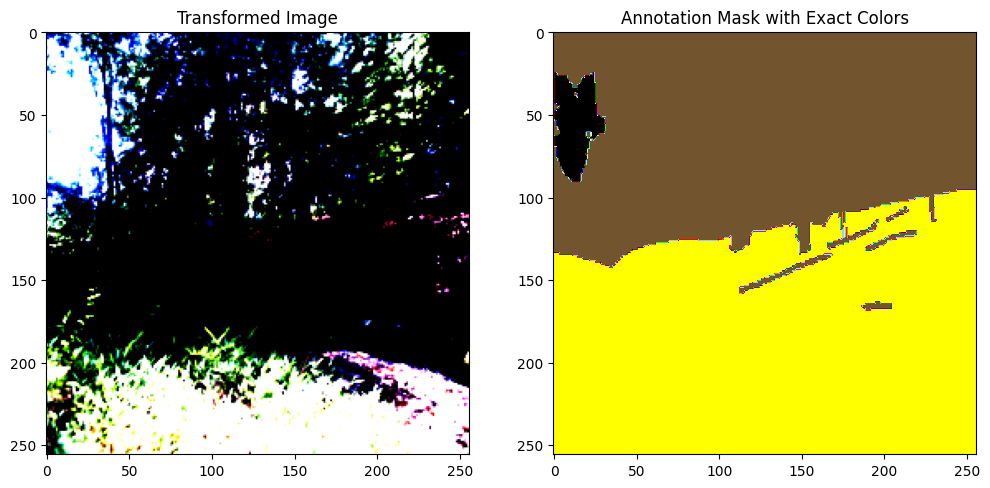

In [20]:

# Reverse the colour_map to get {class_index: RGB_tuple}
index_to_rgb = {v: k for k, v in colour_map.items()}

########## DEBUG SECTION ########################
#print("index_to_rgb:\n")
#print(index_to_rgb)
#print("\n\n")
#for i,j in colour_map.items():
#    print(f"k: {i},  v: {j}")
#debug_flag = input("pausing")
########## DEBUG SECTION END ########################


# Create a list of colors where the index corresponds to the class
num_classes = max(index_to_rgb.keys()) + 1  # Number of classes
cmap_colors = [index_to_rgb[i] if i in index_to_rgb else (0, 0, 0) for i in range(num_classes)]
print("cmap_colors: ",cmap_colors)
cmap_colors = np.array(cmap_colors) / 255.0  # Normalize RGB values to [0, 1] for matplotlib
# Create a ListedColormap with these colors
cmap = ListedColormap(cmap_colors)
# Display the transformed image and its corresponding mask
plt.figure(figsize=(12, 6))

# Display the image
plt.subplot(1, 2, 1)
plt.imshow(images[0].permute(1, 2, 0).numpy())
plt.title("Transformed Image")

# Display the mask with the exact color mapping
plt.subplot(1, 2, 2)
plt.imshow(masks[0].numpy(), cmap=cmap)
plt.title("Annotation Mask with Exact Colors")

plt.show()

In [21]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models import resnet50

# ASPP Module
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels, rates=[6, 12, 18]):
        super(ASPP, self).__init__()
        self.conv_1x1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.conv_3x3_1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=rates[0], dilation=rates[0]),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.conv_3x3_2 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=rates[1], dilation=rates[1]),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.conv_3x3_3 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=rates[2], dilation=rates[2]),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.global_pool = nn.AdaptiveAvgPool2d(1)
        self.conv_1x1_pool = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.final_conv = nn.Sequential(
            nn.Conv2d(out_channels * 5, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x1 = self.conv_1x1(x)
        x2 = self.conv_3x3_1(x)
        x3 = self.conv_3x3_2(x)
        x4 = self.conv_3x3_3(x)
        x5 = self.global_pool(x)
        x5 = self.conv_1x1_pool(x5)
        x5 = F.interpolate(x5, size=x.shape[2:], mode="bilinear", align_corners=False)
        x = torch.cat([x1, x2, x3, x4, x5], dim=1)
        x = self.final_conv(x)
        return x

# SEBlock for Attention
class SEBlock(nn.Module):
    def __init__(self, in_channels, reduction=16):
        super(SEBlock, self).__init__()
        self.global_avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Linear(in_channels, in_channels // reduction, bias=False),
            nn.ReLU(inplace=True),
            nn.Linear(in_channels // reduction, in_channels, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        batch, channels, _, _ = x.size()
        se = self.global_avg_pool(x).view(batch, channels)
        se = self.fc(se).view(batch, channels, 1, 1)
        return x * se

# ResNetUNetASPPWithAttention
class ResNetUNetASPPWithAttention(nn.Module):
    def __init__(self, num_classes=4, aspp_out_channels=256):
        super(ResNetUNetASPPWithAttention, self).__init__()

        # Encoder (ResNet50)
        self.base_model = resnet50(pretrained=True)
        self.base_layers = list(self.base_model.children())

        # ResNet50 encoder stages
        self.encoder1 = nn.Sequential(*self.base_layers[:3])   # 64, 128x128
        self.encoder2 = nn.Sequential(*self.base_layers[3:5])  # 256, 64x64
        self.encoder3 = self.base_layers[5]                    # 512, 32x32
        self.encoder4 = self.base_layers[6]                    # 1024, 16x16
        self.encoder5 = self.base_layers[7]                    # 2048, 8x8

        # ASPP module (input channels = 2048 for ResNet50)
        self.aspp = ASPP(2048, aspp_out_channels)

        # Decoder with Attention
        self.decoder4 = self.conv_block(aspp_out_channels + 1024, 256)  # 1024 from encoder4
        self.decoder3 = self.conv_block(256 + 512, 128)                 # 512 from encoder3
        self.decoder2 = self.conv_block(128 + 256, 64)                  # 256 from encoder2
        self.decoder1 = self.conv_block(64 + 64, 64)                    # 64 from encoder1

        self.att4 = SEBlock(256)
        self.att3 = SEBlock(128)
        self.att2 = SEBlock(64)
        self.att1 = SEBlock(64)

        # Final classifier
        self.classifier = nn.Conv2d(64, num_classes, kernel_size=1)

    def conv_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Dropout2d(p=0.5),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # Encoder
        enc1 = self.encoder1(x)   # 64, 128x128
        enc2 = self.encoder2(enc1) # 256, 64x64
        enc3 = self.encoder3(enc2) # 512, 32x32
        enc4 = self.encoder4(enc3) # 1024, 16x16
        enc5 = self.encoder5(enc4) # 2048, 8x8

        # ASPP
        aspp_out = self.aspp(enc5) # 256, 8x8

        # Decoder with skip connections and attention
        dec4 = F.interpolate(aspp_out, scale_factor=2, mode='bilinear', align_corners=False)
        dec4 = torch.cat([dec4, enc4], dim=1)
        dec4 = self.decoder4(dec4)
        dec4 = self.att4(dec4)

        dec3 = F.interpolate(dec4, scale_factor=2, mode='bilinear', align_corners=False)
        dec3 = torch.cat([dec3, enc3], dim=1)
        dec3 = self.decoder3(dec3)
        dec3 = self.att3(dec3)

        dec2 = F.interpolate(dec3, scale_factor=2, mode='bilinear', align_corners=False)
        dec2 = torch.cat([dec2, enc2], dim=1)
        dec2 = self.decoder2(dec2)
        dec2 = self.att2(dec2)

        dec1 = F.interpolate(dec2, scale_factor=2, mode='bilinear', align_corners=False)
        dec1 = torch.cat([dec1, enc1], dim=1)
        dec1 = self.decoder1(dec1)
        dec1 = self.att1(dec1)

        # Classifier
        out = self.classifier(dec1)
        out = F.interpolate(out, scale_factor=2, mode='bilinear', align_corners=False)
        return out

# Instantiate the model with 4 classes
model = ResNetUNetASPPWithAttention(num_classes=4)


In [22]:
# ##### DEBUG FLAG: ATTEMPT TO GET CLASS WEIGHTS
# from sklearn.utils import class_weight
# from collections import Counter
# import random

# all_labels = []
# #for _, mask in tqdm(train_dataset, desc="Processing Masks"):
# #    all_labels.append(mask.flatten().numpy())
# class_counts = Counter()

# subset_size = 5000  # Adjust the size of the subset
# subset_indices = random.sample(range(len(train_dataset)), subset_size)

# for idx in tqdm(subset_indices, desc="Processing Subset"):
#     _, mask = train_dataset[idx]
#     flat_mask = mask.flatten().numpy()  # Flatten the mask
#     class_counts.update(flat_mask)

# all_labels = np.array(list(class_counts.elements()))
# #all_labels = np.concatenate(all_labels)

# unique_labels = np.unique(all_labels)


# #("len(all_labels: ", len(all_labels), ",  all_labels: ",all_labels)

# class_weights = class_weight.compute_class_weight(
#     class_weight='balanced',  # Can be 'balanced' or you can manually specify weights
#     classes=unique_labels,
#     y=all_labels
# )
class_weights = np.array([3.43445427, 0.56273723, 58.62133945, 0.5222625])
class_weights = torch.tensor(class_weights, dtype=torch.float32, device='cuda' if torch.cuda.is_available() else 'cpu')

print(class_weights)

tensor([ 3.4345,  0.5627, 58.6213,  0.5223], device='cuda:0')


In [ ]:
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Move the model to the chosen device
model = model.to(device)

# Define optimizer, loss function, and scheduler

#class_weights = torch.tensor(class_weights, dtype=torch.float, device=device)  # Class weights

optimizer = optim.Adam(model.parameters(), lr=0.001)

#criterion = nn.CrossEntropyLoss(weight=class_weights)

################ DEBUG FLAG START ###################
#class_weights = torch.tensor(class_weights, dtype=torch.float, device=device)  # Class weights
criterion = nn.CrossEntropyLoss(weight=class_weights)
#criterion = nn.CrossEntropyLoss()
################ DEBUG FLAG END ###################

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=3, factor=0.5, verbose=True)

# Attempt to load checkpoint
try:
    checkpoint = torch.load('best_model.pth')
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
    min_val_loss = checkpoint['min_val_loss']
    print("Resuming training from saved model...")
except FileNotFoundError:
    min_val_loss = float('inf')
    print("'best_model.pth' not found. Starting training from scratch...")

# Training parameters
num_epochs = 50
patience = 7
not_improve_count = 0
early_stop = False

# Dice Score function
def dice_score(pred, target):
    pred = torch.argmax(pred, dim=1)  # Convert logits to class predictions
    smooth = 1e-6
    intersection = (pred * target).sum()
    return (2.0 * intersection + smooth) / (pred.sum() + target.sum() + smooth)

# Training loop
for epoch in range(num_epochs):
    if early_stop:
        break

    model.train()
    epoch_loss = 0

    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch + 1}/{num_epochs}"):
        images, masks = images.to(device), masks.to(device)

        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, masks)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)  # Gradient clipping
        optimizer.step()

        # Track training loss
        epoch_loss += loss.item()

    # Calculate average training loss
    avg_train_loss = epoch_loss / len(train_loader)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Training Loss: {avg_train_loss:.4f}")

    # Validation step
    model.eval()
    val_loss = 0
    dice = 0
    with torch.no_grad():
        for images, masks in val_loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            val_loss += loss.item()
            dice += dice_score(outputs, masks).item()

    avg_val_loss = val_loss / len(val_loader)
    avg_dice_score = dice / len(val_loader)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}, Dice Score: {avg_dice_score:.4f}")

    # Adjust learning rate
    scheduler.step(avg_val_loss)

    # Early stopping and checkpoint saving
    if avg_val_loss < min_val_loss:
        min_val_loss = avg_val_loss
        not_improve_count = 0
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'min_val_loss': min_val_loss,
        }, 'best_model.pth')
        print(f"Validation loss decreased to {min_val_loss:.4f}, saving model.")
    else:
        not_improve_count += 1
        print(f"Loss did not decrease for {not_improve_count} time(s)")
        if not_improve_count >= patience:
            print(f"Early stopping triggered after {patience} epochs without improvement.")
            early_stop = True

# Load the best model
checkpoint = torch.load('best_model.pth')
model.load_state_dict(checkpoint['model_state_dict'])
print("Loaded best model based on validation loss.")


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
<ipython-input-10-66d82b596a40>:30: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of t

'best_model.pth' not found. Starting training from scratch...


Epoch 1/50: 100%|██████████| 173/173 [03:36<00:00,  1.25s/it]


Epoch [1/50], Training Loss: 0.4545
Epoch [1/50], Validation Loss: 0.3376, Dice Score: 2.3335
Validation loss decreased to 0.3376, saving model.


Epoch 2/50: 100%|██████████| 173/173 [03:25<00:00,  1.19s/it]


Epoch [2/50], Training Loss: 0.2506
Epoch [2/50], Validation Loss: 0.3799, Dice Score: 2.3803
Loss did not decrease for 1 time(s)


Epoch 3/50: 100%|██████████| 173/173 [03:19<00:00,  1.15s/it]


Epoch [3/50], Training Loss: 0.2293
Epoch [3/50], Validation Loss: 0.2786, Dice Score: 2.3157
Validation loss decreased to 0.2786, saving model.


Epoch 4/50: 100%|██████████| 173/173 [03:18<00:00,  1.14s/it]


Epoch [4/50], Training Loss: 0.2107
Epoch [4/50], Validation Loss: 0.2894, Dice Score: 2.3748
Loss did not decrease for 1 time(s)


Epoch 5/50: 100%|██████████| 173/173 [03:18<00:00,  1.15s/it]


Epoch [5/50], Training Loss: 0.1955
Epoch [5/50], Validation Loss: 0.2673, Dice Score: 2.3787
Validation loss decreased to 0.2673, saving model.


Epoch 6/50: 100%|██████████| 173/173 [03:19<00:00,  1.15s/it]


Epoch [6/50], Training Loss: 0.1829
Epoch [6/50], Validation Loss: 0.2436, Dice Score: 2.3697
Validation loss decreased to 0.2436, saving model.


Epoch 7/50: 100%|██████████| 173/173 [03:18<00:00,  1.15s/it]


Epoch [7/50], Training Loss: 0.1856
Epoch [7/50], Validation Loss: 0.3094, Dice Score: 2.3691
Loss did not decrease for 1 time(s)


Epoch 8/50: 100%|██████████| 173/173 [03:18<00:00,  1.15s/it]


Epoch [8/50], Training Loss: 0.1725
Epoch [8/50], Validation Loss: 0.2600, Dice Score: 2.3753
Loss did not decrease for 2 time(s)


Epoch 9/50: 100%|██████████| 173/173 [03:18<00:00,  1.15s/it]


Epoch [9/50], Training Loss: 0.1684
Epoch [9/50], Validation Loss: 0.2557, Dice Score: 2.3813
Loss did not decrease for 3 time(s)


Epoch 10/50: 100%|██████████| 173/173 [03:19<00:00,  1.16s/it]


Epoch [10/50], Training Loss: 0.1766
Epoch [10/50], Validation Loss: 0.2566, Dice Score: 2.3822
Loss did not decrease for 4 time(s)


Epoch 11/50: 100%|██████████| 173/173 [03:18<00:00,  1.15s/it]


Epoch [11/50], Training Loss: 0.1540
Epoch [11/50], Validation Loss: 0.2832, Dice Score: 2.3810
Loss did not decrease for 5 time(s)


Epoch 12/50: 100%|██████████| 173/173 [03:18<00:00,  1.15s/it]


Epoch [12/50], Training Loss: 0.1486
Epoch [12/50], Validation Loss: 0.2580, Dice Score: 2.3754
Loss did not decrease for 6 time(s)


Epoch 13/50: 100%|██████████| 173/173 [03:17<00:00,  1.14s/it]


Epoch [13/50], Training Loss: 0.1426
Epoch [13/50], Validation Loss: 0.2556, Dice Score: 2.3913
Loss did not decrease for 7 time(s)
Early stopping triggered after 7 epochs without improvement.


<ipython-input-10-66d82b596a40>:120: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('best_model.pth')


Loaded best model based on validation loss.


In [35]:
checkpoint = torch.load('/content/best_model (7).pth')
model.load_state_dict(checkpoint['model_state_dict'])
# ptimizer.load_state_dict(checkpoint['optimizer_state_dict'])
# current_epoch = checkpoint['epoch']o
# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Move the model to the device
model = model.to(device)


In [36]:
import torch
!pip install torchmetrics
from torchmetrics.classification import MulticlassJaccardIndex, MulticlassAccuracy
import matplotlib.pyplot as plt
import numpy as np

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Initialize metrics for 4 classes
num_classes = 4
iou_metric = MulticlassJaccardIndex(num_classes=num_classes, average=None).to(device)  # Per-class IoU
pixel_accuracy_metric = MulticlassAccuracy(num_classes=num_classes, average='micro').to(device)  # Pixel Accuracy
mean_pixel_accuracy_metric = MulticlassAccuracy(num_classes=num_classes, average='macro').to(device)  # Mean Pixel Accuracy
per_class_accuracy_metric = MulticlassAccuracy(num_classes=num_classes, average=None).to(device)  # Per-class accuracy

# Switch model to evaluation mode
model.eval()

# Class mapping for 4 classes
class_map = {
    0: "Background",
    1: "Smooth Navigable",
    2: "Rough Navigable",
    3: "Obstacles/Bumpy Navigable"
}

# Optional: Visualization color palette
GROUP_PALETTE = {
    0: [0, 0, 0],        # Background (black)
    1: [128, 128, 128],  # Smooth navigable (gray)
    2: [0, 255, 0],      # Rough navigable (green)
    3: [255, 0, 0]       # Obstacles/Bumpy navigable (red)
}

# Visualization helper
def visualize_mask(mask, palette):
    """Convert a grouped mask to RGB for visualization."""
    h, w = mask.shape
    rgb_mask = np.zeros((h, w, 3), dtype=np.uint8)
    for group, color in palette.items():
        rgb_mask[mask == group] = color
    return rgb_mask

# Evaluation loop
iou_scores = []
pixel_accuracies = []
mean_pixel_accuracies = []
per_class_accuracies = []

with torch.no_grad():
    for images, masks in test_loader:
        images, masks = images.to(device), masks.to(device)

        # Forward pass
        outputs = model(images)
        predictions = torch.argmax(outputs, dim=1)  # Get predicted class for each pixel

        # Calculate metrics
        iou_scores.append(iou_metric(predictions, masks).cpu())  # Convert to CPU for aggregation
        pixel_accuracies.append(pixel_accuracy_metric(predictions, masks).cpu())
        mean_pixel_accuracies.append(mean_pixel_accuracy_metric(predictions, masks).cpu())
        per_class_accuracies.append(per_class_accuracy_metric(predictions, masks).cpu())

# Aggregate results
iou_scores = torch.stack(iou_scores).mean(dim=0)  # Per-class IoU
pixel_accuracy = torch.tensor(pixel_accuracies).mean().item()
mean_pixel_accuracy = torch.tensor(mean_pixel_accuracies).mean().item()
per_class_accuracies = torch.stack(per_class_accuracies).mean(dim=0)  # Per-class accuracy

# Print results
print(f"Pixel Accuracy: {pixel_accuracy * 100:.2f}%")
print(f"Mean Pixel Accuracy: {mean_pixel_accuracy * 100:.2f}%")
print("\nPer-class IoU:")
for i, iou in enumerate(iou_scores):
    print(f"{class_map[i]}: IoU = {iou.item() * 100:.2f}%")
print(f"\nMean IoU: {iou_scores.mean().item() * 100:.2f}%")

print("\nPer-class Accuracy:")
for i, acc in enumerate(per_class_accuracies):
    print(f"{class_map[i]}: Accuracy = {acc.item() * 100:.2f}%")




Pixel Accuracy: 92.16%
Mean Pixel Accuracy: 74.11%

Per-class IoU:
Background: IoU = 70.26%
Smooth Navigable: IoU = 91.03%
Rough Navigable: IoU = 0.26%
Obstacles/Bumpy Navigable: IoU = 83.96%

Mean IoU: 61.38%

Per-class Accuracy:
Background: Accuracy = 96.95%
Smooth Navigable: Accuracy = 96.80%
Rough Navigable: Accuracy = 2.26%
Obstacles/Bumpy Navigable: Accuracy = 86.50%


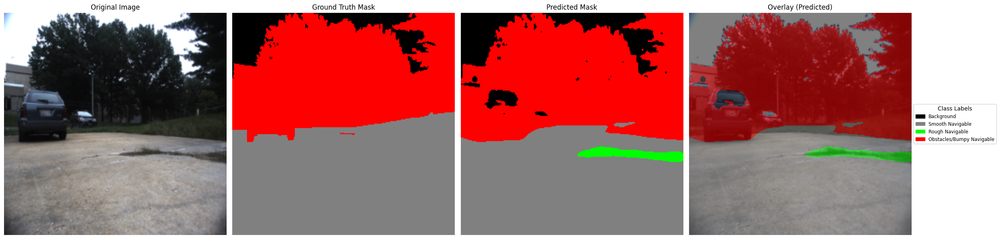

In [37]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cv2  # Ensure OpenCV is installed

# Define normalization parameters
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Colour map for 4 classes
colour_map = {
    0: (0, 0, 0),       # Background
    1: (128, 128, 128), # Smooth Navigable
    2: (0, 255, 0),     # Rough Navigable
    3: (255, 0, 0)      # Obstacles/Bumpy Navigable
}

# Class map for 4 classes
class_map = {
    0: "Background",
    1: "Smooth Navigable",
    2: "Rough Navigable",
    3: "Obstacles/Bumpy Navigable"
}

# Helper functions
def unnormalize_image(image, mean, std):
    """Unnormalize a single image."""
    image = image.clone().cpu()
    for c in range(image.shape[0]):
        image[c] = image[c] * std[c] + mean[c]
    image = image.permute(1, 2, 0).numpy()
    return (image * 255).clip(0, 255).astype(np.uint8)

def convert_to_rgb(mask, colour_map):
    """Convert a segmentation mask to RGB using the colour map."""
    height, width = mask.shape
    rgb_image = np.zeros((height, width, 3), dtype=np.uint8)
    for class_idx, rgb in colour_map.items():
        rgb_image[mask == class_idx] = rgb
    return rgb_image

def generate_legend(class_map, colour_map):
    """Generate a legend for visualization."""
    legend_patches = []
    for class_idx, rgb in colour_map.items():
        class_name = class_map[class_idx]
        legend_patches.append(mpatches.Patch(color=np.array(rgb) / 255, label=class_name))
    return legend_patches

def overlay_mask(input_image, mask, alpha=0.5):
    """Overlay a mask on the input image."""
    overlay = cv2.addWeighted(input_image, 1 - alpha, mask, alpha, 0)
    return overlay

# Switch model to evaluation mode
model.eval()

# Visualization and evaluation loop
with torch.no_grad():
    for images, masks in test_loader:
        images, masks = images.to(device), masks.to(device)

        # Forward pass
        outputs = model(images)
        predictions = torch.argmax(outputs, dim=1)  # Shape: (batch_size, H, W)

        # Extract the first sample for visualization
        input_image = unnormalize_image(images[0], mean, std)  # Un-normalize the first image
        predicted_mask = predictions[0].cpu().numpy()  # Convert predicted mask to NumPy
        original_mask = masks[0].cpu().numpy()  # Convert ground truth mask to NumPy

        # Convert masks to RGB for visualization
        visualized_predicted_mask = convert_to_rgb(predicted_mask, colour_map)
        visualized_original_mask = convert_to_rgb(original_mask, colour_map)

        # Create overlay for predicted mask
        overlay = overlay_mask(input_image, visualized_predicted_mask, alpha=0.5)

        # Display results
        plt.figure(figsize=(25, 6))

        plt.subplot(1, 4, 1)
        plt.title("Original Image")
        plt.imshow(input_image)
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.title("Ground Truth Mask")
        plt.imshow(visualized_original_mask)
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.title("Predicted Mask")
        plt.imshow(visualized_predicted_mask)
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.title("Overlay (Predicted)")
        plt.imshow(overlay)
        plt.axis('off')

        # Add legend for class labels
        legend_patches = generate_legend(class_map, colour_map)
        plt.legend(
            handles=legend_patches,
            loc='center left',
            bbox_to_anchor=(1, 0.5),
            title="Class Labels",
            fontsize='small'
        )

        plt.tight_layout()
        plt.show()

        # Break after visualizing one batch
        break


Plot saved to: /content/drive/MyDrive/rugd_results/park-2_1.png


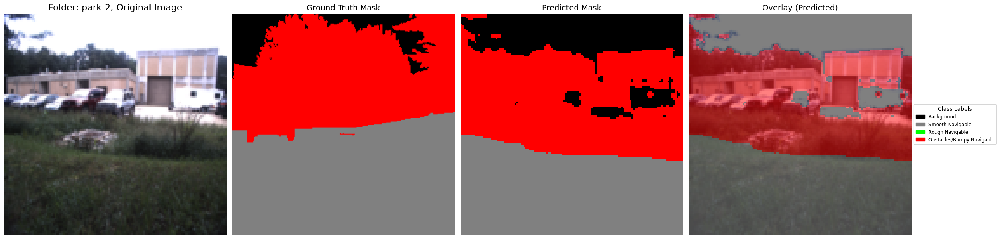

Plot saved to: /content/drive/MyDrive/rugd_results/park-8_1.png


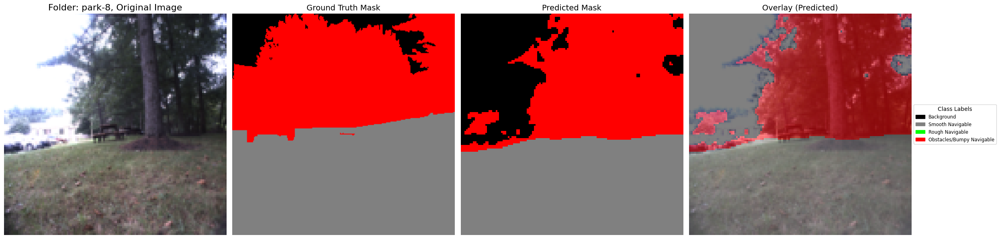

Plot saved to: /content/drive/MyDrive/rugd_results/creek_1.png


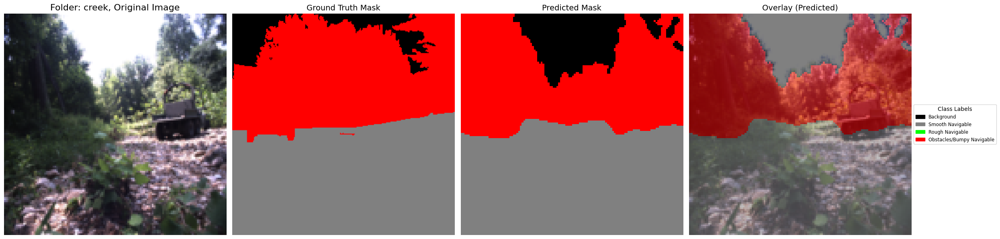

Plot saved to: /content/drive/MyDrive/rugd_results/trail_1.png


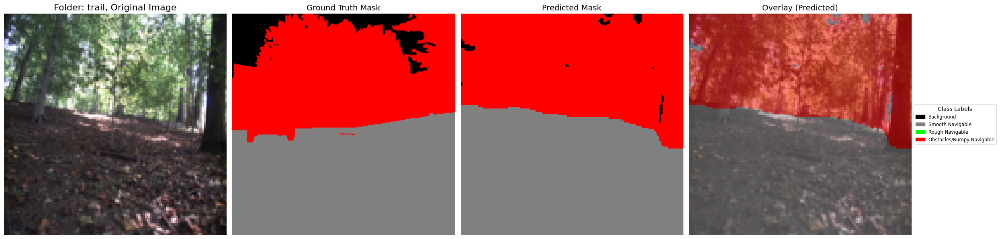

Plot saved to: /content/drive/MyDrive/rugd_results/trail-3_1.png


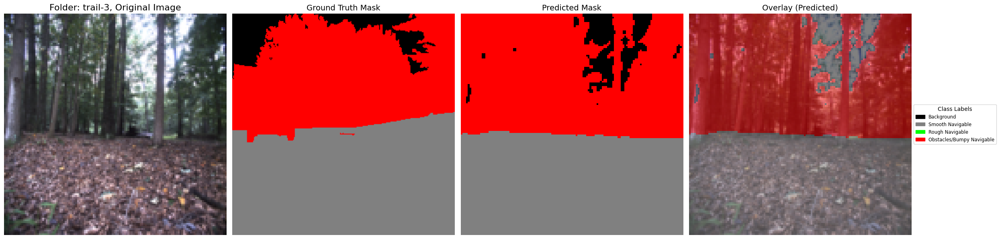

Plot saved to: /content/drive/MyDrive/rugd_results/trail-4_1.png


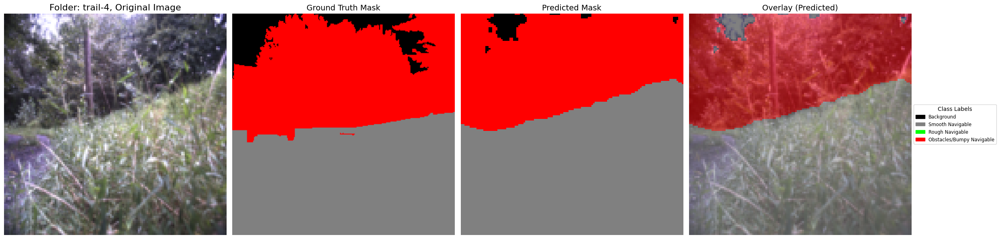

Plot saved to: /content/drive/MyDrive/rugd_results/trail-9_1.png


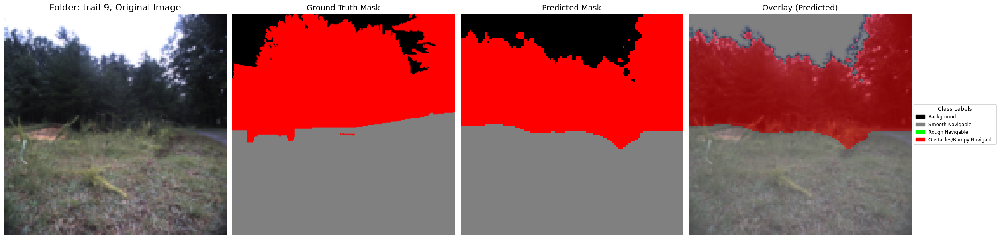

Plot saved to: /content/drive/MyDrive/rugd_results/trail-10_1.png


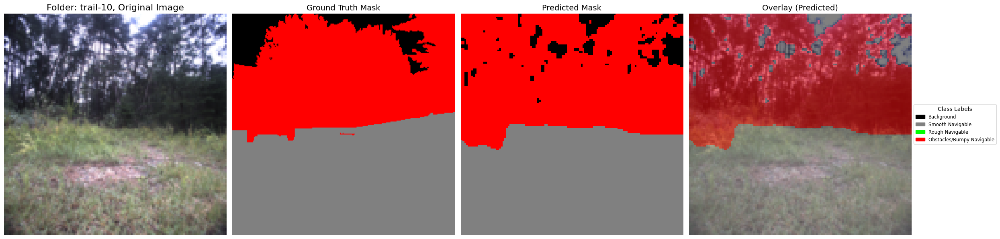

Plot saved to: /content/drive/MyDrive/rugd_results/trail-11_1.png


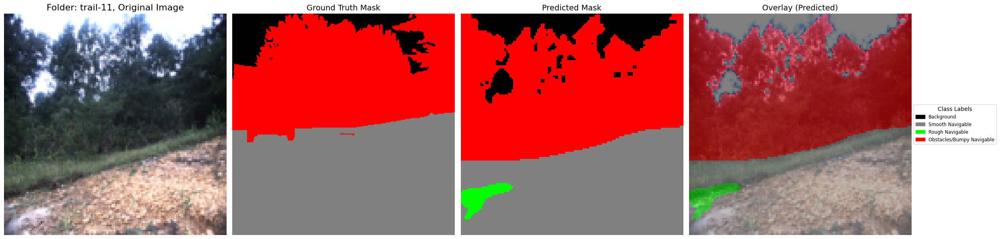

Plot saved to: /content/drive/MyDrive/rugd_results/trail-12_1.png


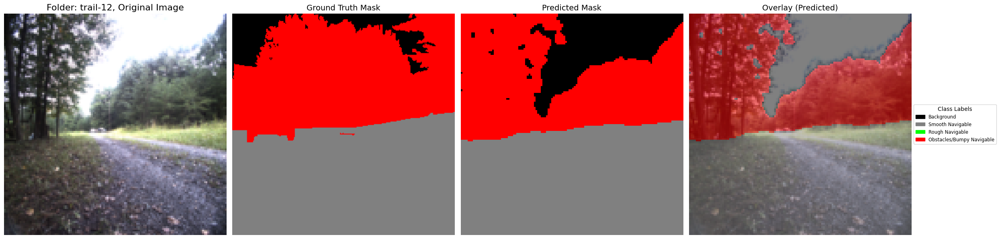

Plot saved to: /content/drive/MyDrive/rugd_results/trail-14_1.png


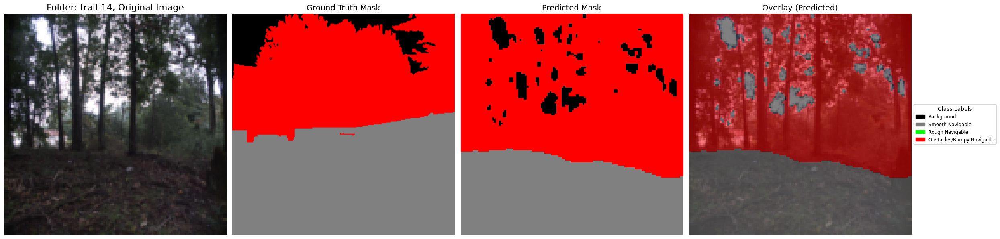

Plot saved to: /content/drive/MyDrive/rugd_results/trail-15_1.png


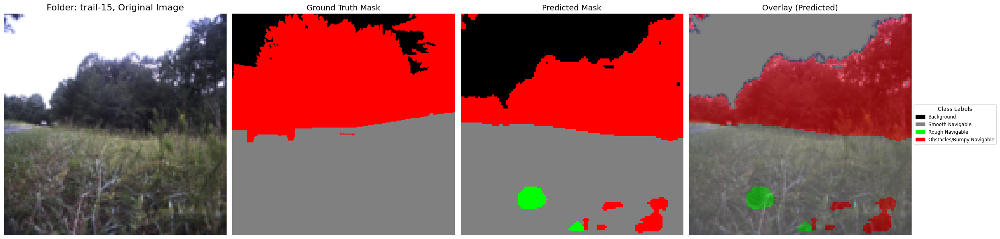

Plot saved to: /content/drive/MyDrive/rugd_results/village_1.png


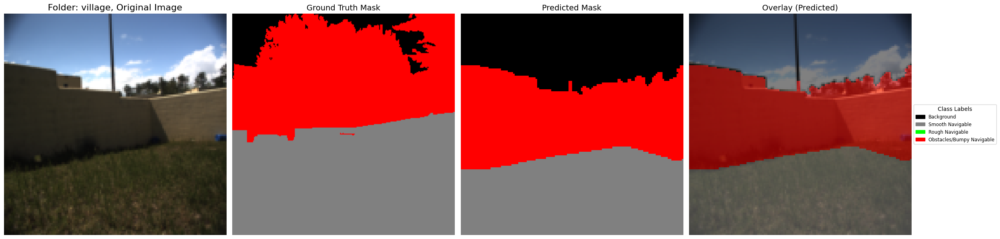

Plot saved to: /content/drive/MyDrive/rugd_results/trail-6_1.png


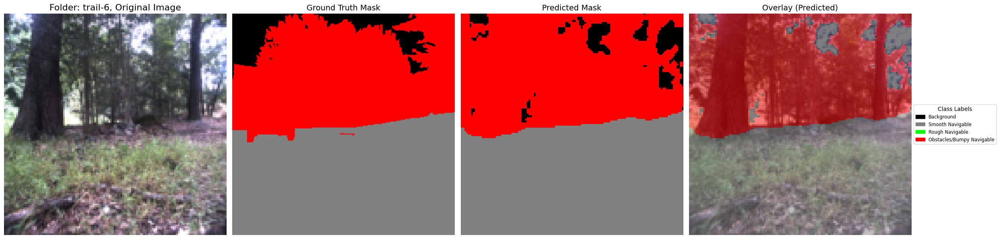

Plot saved to: /content/drive/MyDrive/rugd_results/trail-5_1.png


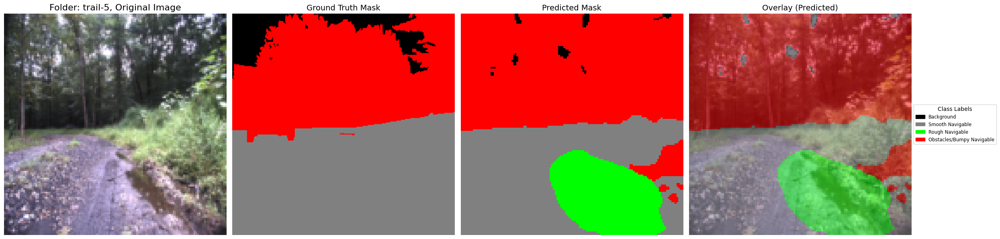

Plot saved to: /content/drive/MyDrive/rugd_results/park-1_1.png


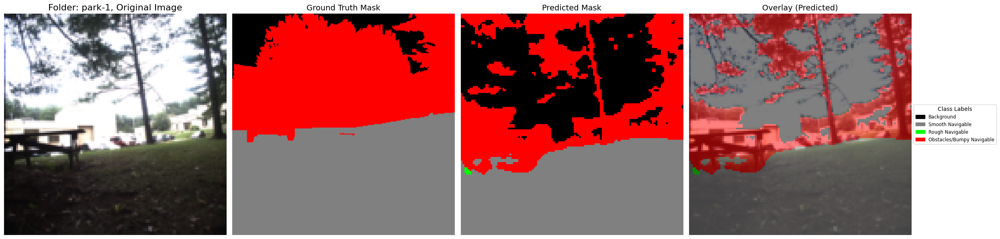

Plot saved to: /content/drive/MyDrive/rugd_results/trail-7_1.png


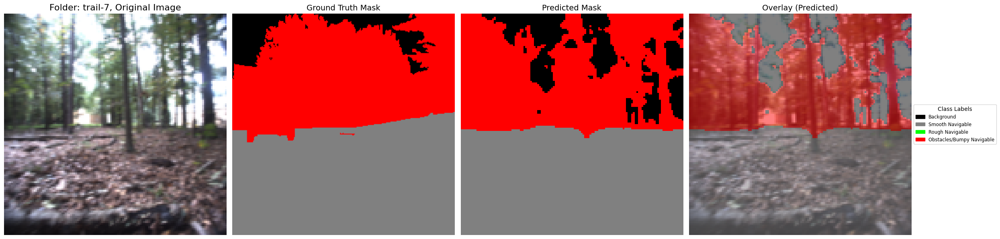

Plot saved to: /content/drive/MyDrive/rugd_results/trail-13_1.png


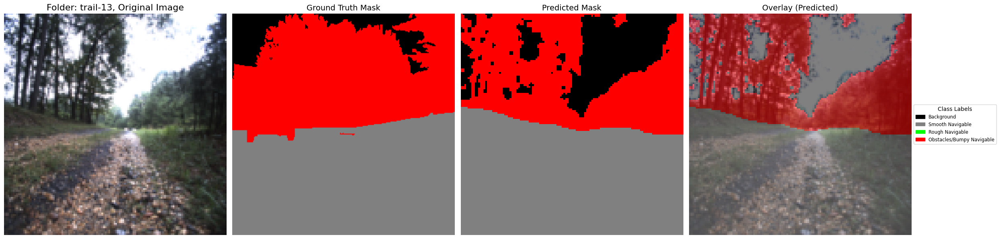

In [78]:
import os
import random
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cv2
from PIL import Image
from torchvision import transforms

# Define normalization parameters
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Colour map and class map
colour_map = {
    0: (0, 0, 0),       # Background
    1: (128, 128, 128), # Smooth Navigable
    2: (0, 255, 0),     # Rough Navigable
    3: (255, 0, 0)      # Obstacles/Bumpy Navigable
}

class_map = {
    0: "Background",
    1: "Smooth Navigable",
    2: "Rough Navigable",
    3: "Obstacles"
}

# Reverse map for RGB to class index
rgb_to_class = {v: k for k, v in colour_map.items()}
save_dir = '/content/drive/MyDrive/rugd_results'

def rgb_to_class_indices(rgb_mask, rgb_to_class):
    """
    Converts an RGB segmentation mask to class indices using a color map.

    Args:
        rgb_mask (numpy.ndarray): RGB mask with shape (H, W, 3).
        rgb_to_class (dict): Mapping from RGB tuple to class index.

    Returns:
        numpy.ndarray: 2D array with shape (H, W) containing class indices.
    """
    height, width, _ = rgb_mask.shape
    class_indices = np.zeros((height, width), dtype=np.int32)

    for rgb, class_idx in rgb_to_class.items():
        mask = np.all(rgb_mask == np.array(rgb), axis=-1)
        class_indices[mask] = class_idx

    return class_indices

def unnormalize_image(image, mean, std):
    """Unnormalize a single image."""
    image = image.clone().cpu()
    for c in range(image.shape[0]):
        image[c] = image[c] * std[c] + mean[c]
    image = image.permute(1, 2, 0).numpy()
    return (image * 255).clip(0, 255).astype(np.uint8)

def convert_to_rgb(mask, colour_map):
    """Convert a segmentation mask to RGB using the colour map."""
    height, width = mask.shape
    rgb_image = np.zeros((height, width, 3), dtype=np.uint8)
    for class_idx, rgb in colour_map.items():
        rgb_image[mask == class_idx] = rgb
    return rgb_image

def overlay_mask(input_image, mask, alpha=0.5):
    """Overlay a mask on the input image."""
    overlay = cv2.addWeighted(input_image, 1 - alpha, mask, alpha, 0)
    return overlay

def generate_legend(class_map, colour_map):
    """Generate legend patches for visualization."""
    legend_patches = []
    for class_idx, class_name in class_map.items():
        color = np.array(colour_map[class_idx]) / 255.0
        legend_patches.append(mpatches.Patch(color=color, label=class_name))
    return legend_patches

def display_results(input_image, ground_truth_mask, predicted_mask, overlay,folder_name, class_map, colour_map):
    """
    Displays the original image, ground truth mask, predicted mask, and overlay in a grid with a legend.

    Args:
        input_image (numpy.ndarray): The input image (unnormalized).
        ground_truth_mask (numpy.ndarray): The ground truth segmentation mask.
        predicted_mask (numpy.ndarray): The predicted segmentation mask.
        overlay (numpy.ndarray): The overlay of the predicted mask on the original image.
        class_map (dict): Dictionary mapping class indices to class names.
        colour_map (dict): Dictionary mapping class indices to RGB values.
    """
    # Create a figure
    plt.figure(figsize=(25, 6))

    # Plot the original image
    plt.subplot(1, 4, 1)
    plt.title(f"Folder: {folder_name}, Original Image", fontsize=16)
    plt.imshow(input_image)
    plt.axis('off')

    # Plot the ground truth mask
    plt.subplot(1, 4, 2)
    plt.title("Ground Truth Mask", fontsize=14)
    plt.imshow(ground_truth_mask)
    plt.axis('off')

    # Plot the predicted mask
    plt.subplot(1, 4, 3)
    plt.title("Predicted Mask", fontsize=14)
    plt.imshow(predicted_mask)
    plt.axis('off')

    # Plot the overlay
    plt.subplot(1, 4, 4)
    plt.title("Overlay (Predicted)", fontsize=14)
    plt.imshow(overlay)
    plt.axis('off')
    # Generate and display the legend
    legend_patches = generate_legend(class_map, colour_map)
    plt.legend(
        handles=legend_patches,
        loc='center left',
        bbox_to_anchor=(1, 0.5),
        title="Class Labels",
        fontsize='small'
    )

    # Adjust layout
    plt.tight_layout()
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)  # Create the directory if it doesn't exist
    save_path = os.path.join(save_dir, f"{folder_name}_1.png")
    plt.savefig(save_path, bbox_inches='tight')
    print(f"Plot saved to: {save_path}")
    plt.show()

root_dir = '/content/rugd/rugd/RUGD_frames-with-annotations/RUGD_frames-with-annotations/'  # Update with the path to your dataset
folders = ['park-2', 'park-8', 'creek', 'trail', 'trail-3', 'trail-4', 'trail-9', 'trail-10', 'trail-11',
           'trail-12', 'trail-14', 'trail-15', 'village','trail-6', 'trail-5','park-1', 'trail-7', 'trail-13']

sampled_image_paths = [
    os.path.join(root_dir, folder, random.choice(os.listdir(os.path.join(root_dir, folder))))
    for folder in folders
]

model.eval()

with torch.no_grad():
    for img_path in sampled_image_paths:
        img = Image.open(img_path).convert("RGB")
        folder_name = os.path.basename(os.path.dirname(img_path))

        # Load the ground truth
        ground_truth_path = img_path.replace("images", "annotations")  # Adjust path as needed
        ground_truth = np.array(Image.open(ground_truth_path))


        # Apply transformations to the input image
        transform = transforms.Compose([
            transforms.Resize((128, 128)),
            transforms.ToTensor(),
            transforms.Normalize(mean=mean, std=std)
        ])
        input_image = transform(img).unsqueeze(0).to(device)

        # Perform forward pass
        outputs = model(input_image)
        predictions = torch.argmax(outputs, dim=1)

        # Process results
        input_image_unnormalized = unnormalize_image(input_image[0], mean, std)
        predicted_mask = convert_to_rgb(predictions[0].cpu().numpy(), colour_map)
        ground_truth_mask = convert_to_rgb(masks[i].cpu().numpy(), colour_map)

        # # Debug: Check shapes of predictions and ground truth masks
        # print(f"Predicted mask shape: {predictions[0].shape}")
        # print(f"Processed ground truth mask shape: {ground_truth.shape}")

        # Create overlay
        overlay = overlay_mask(input_image_unnormalized, predicted_mask, alpha=0.5)

        # Display results
        display_results(
            input_image=input_image_unnormalized,
            ground_truth_mask=ground_truth_mask,
            predicted_mask=predicted_mask,
            overlay=overlay,
            folder_name=folder_name,
            class_map=class_map,
            colour_map=colour_map
        )


Plot saved to: /content/drive/MyDrive/rugd_results/park-2_1.png


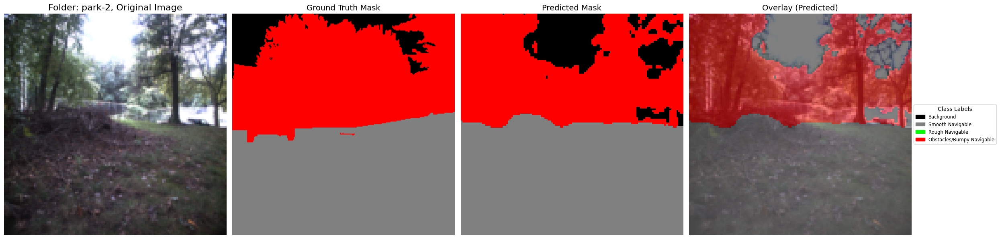

Plot saved to: /content/drive/MyDrive/rugd_results/park-8_1.png


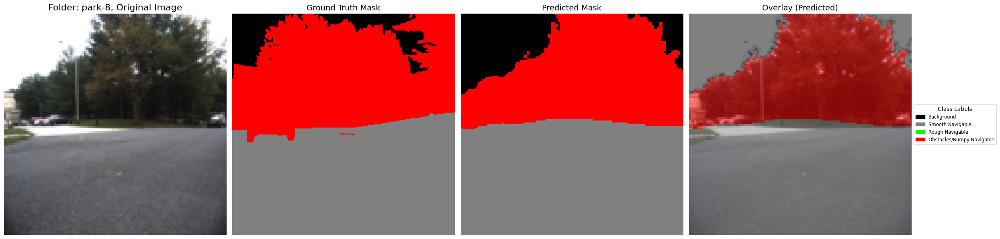

Plot saved to: /content/drive/MyDrive/rugd_results/creek_1.png


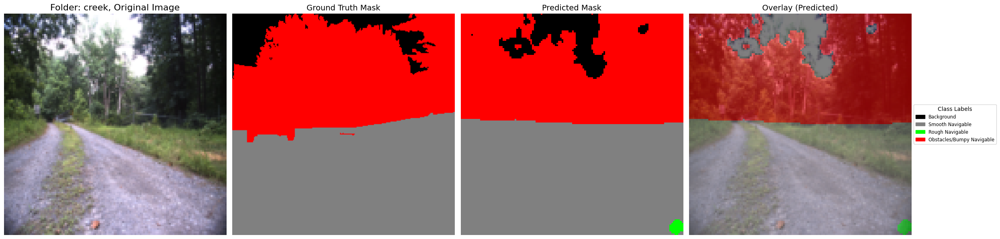

Plot saved to: /content/drive/MyDrive/rugd_results/trail_1.png


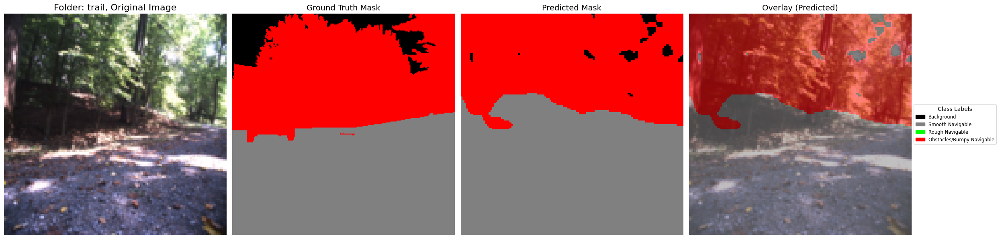

Plot saved to: /content/drive/MyDrive/rugd_results/trail-3_1.png


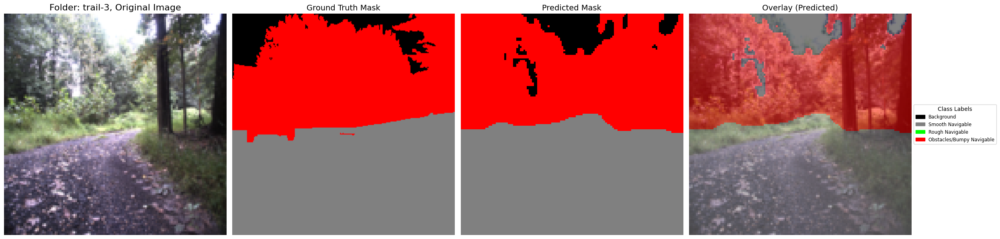

Plot saved to: /content/drive/MyDrive/rugd_results/trail-4_1.png


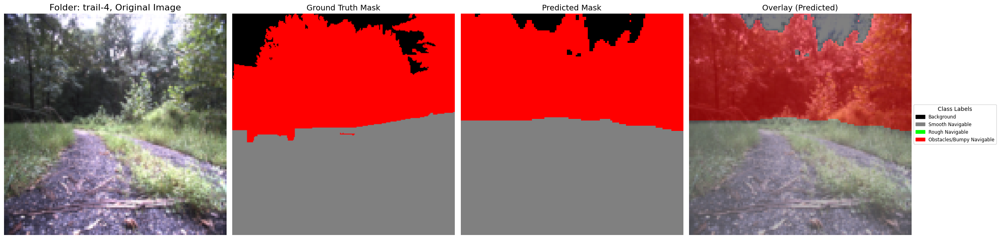

Plot saved to: /content/drive/MyDrive/rugd_results/trail-9_1.png


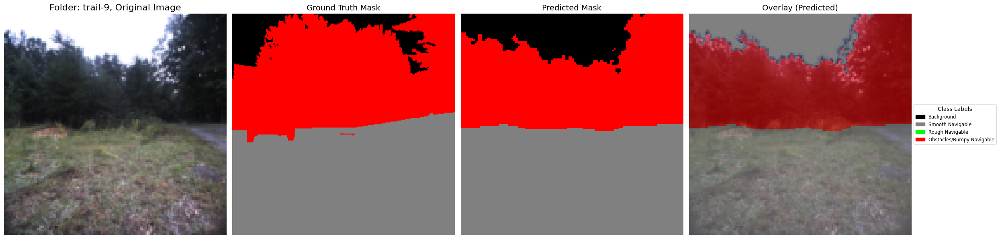

Plot saved to: /content/drive/MyDrive/rugd_results/trail-10_1.png


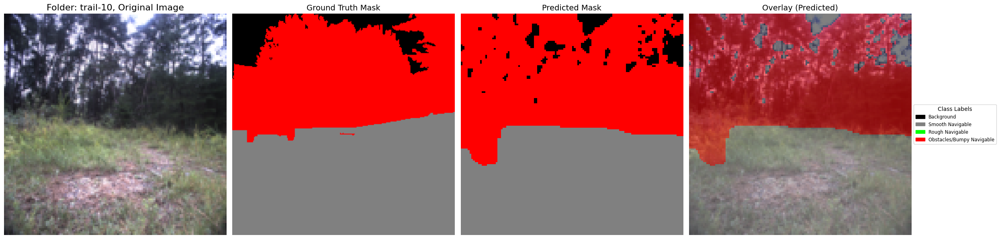

Plot saved to: /content/drive/MyDrive/rugd_results/trail-11_1.png


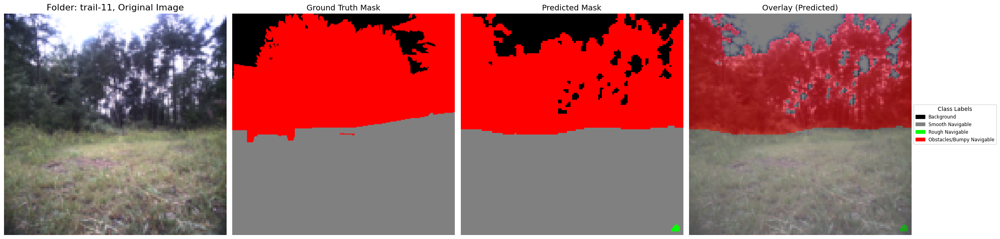

Plot saved to: /content/drive/MyDrive/rugd_results/trail-12_1.png


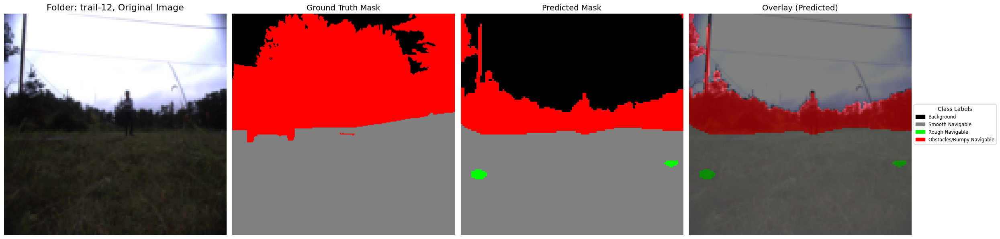

Plot saved to: /content/drive/MyDrive/rugd_results/trail-14_1.png


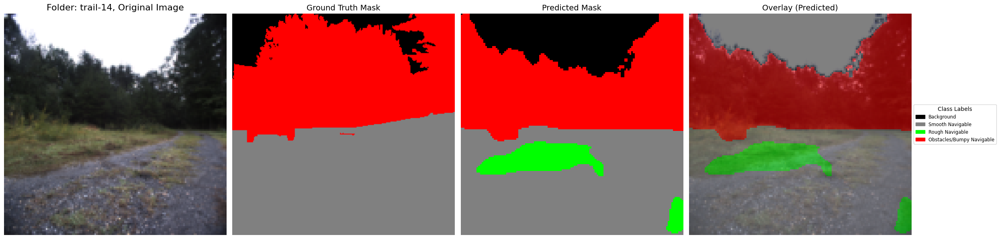

Plot saved to: /content/drive/MyDrive/rugd_results/trail-15_1.png


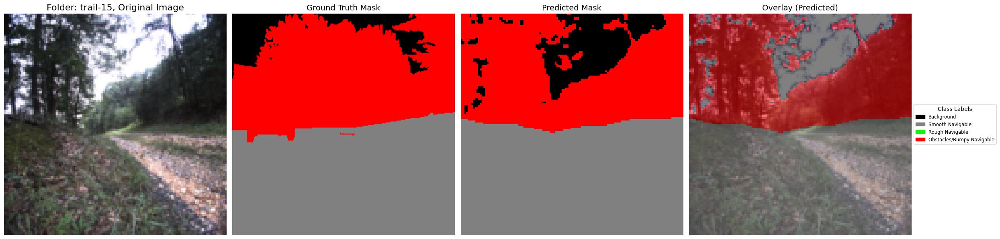

Plot saved to: /content/drive/MyDrive/rugd_results/village_1.png


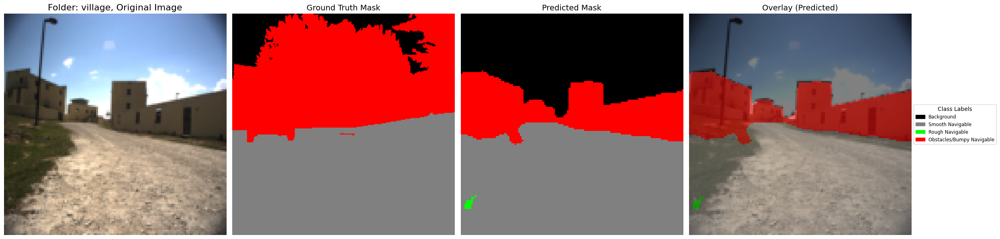

Plot saved to: /content/drive/MyDrive/rugd_results/trail-6_1.png


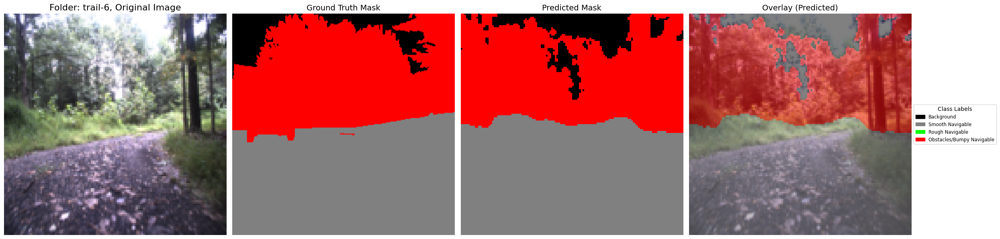

Plot saved to: /content/drive/MyDrive/rugd_results/trail-5_1.png


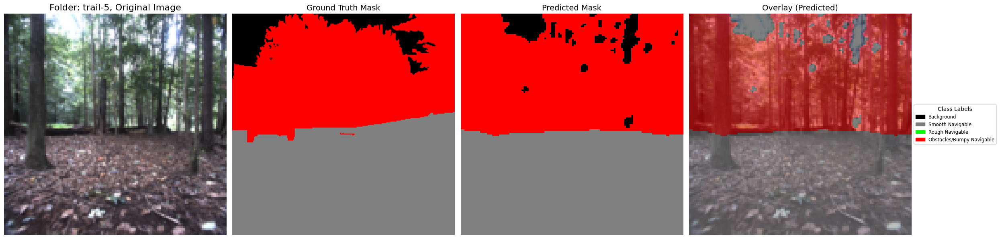

Plot saved to: /content/drive/MyDrive/rugd_results/park-1_1.png


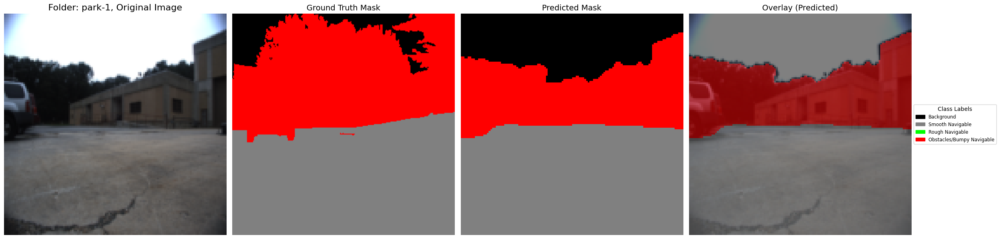

Plot saved to: /content/drive/MyDrive/rugd_results/trail-7_1.png


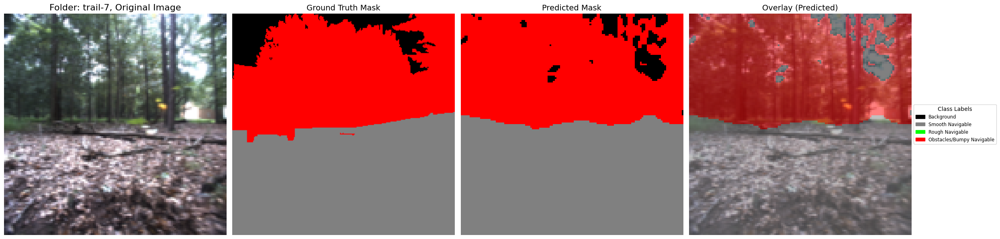

Plot saved to: /content/drive/MyDrive/rugd_results/trail-13_1.png


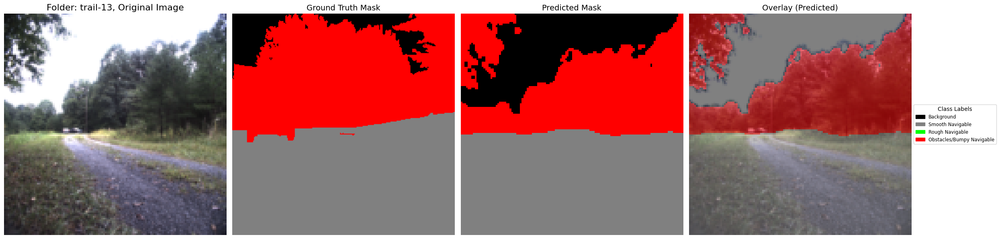

In [87]:
# import os
# import random
# import torch
# import numpy as np
# import matplotlib.pyplot as plt
# import matplotlib.patches as mpatches
# import cv2
# from PIL import Image
# from torchvision import transforms

# # Define normalization parameters
# mean = [0.485, 0.456, 0.406]
# std = [0.229, 0.224, 0.225]

# # Colour map and class map
# colour_map = {
#     0: (0, 0, 0),       # Background
#     1: (128, 128, 128), # Smooth Navigable
#     2: (0, 255, 0),     # Rough Navigable
#     3: (255, 0, 0)      # Obstacles/Bumpy Navigable
# }

# class_map = {
#     0: "Background",
#     1: "Smooth Navigable",
#     2: "Rough Navigable",
#     3: "Obstacles/Bumpy Navigable"
# }

# # Reverse map for RGB to class index
# rgb_to_class = {v: k for k, v in colour_map.items()}
# save_dir = '/content/drive/MyDrive/rugd_results'

# def rgb_to_class_indices(rgb_mask, rgb_to_class):
#     """
#     Converts an RGB segmentation mask to class indices using a color map.

#     Args:
#         rgb_mask (numpy.ndarray): RGB mask with shape (H, W, 3).
#         rgb_to_class (dict): Mapping from RGB tuple to class index.

#     Returns:
#         numpy.ndarray: 2D array with shape (H, W) containing class indices.
#     """
#     height, width, _ = rgb_mask.shape
#     class_indices = np.zeros((height, width), dtype=np.int32)

#     for rgb, class_idx in rgb_to_class.items():
#         mask = np.all(rgb_mask == np.array(rgb), axis=-1)
#         class_indices[mask] = class_idx

#     return class_indices

# def unnormalize_image(image, mean, std):
#     """Unnormalize a single image."""
#     image = image.clone().cpu()
#     for c in range(image.shape[0]):
#         image[c] = image[c] * std[c] + mean[c]
#     image = image.permute(1, 2, 0).numpy()
#     return (image * 255).clip(0, 255).astype(np.uint8)

# def convert_to_rgb(mask, colour_map):
#     """Convert a segmentation mask to RGB using the colour map."""
#     height, width = mask.shape
#     rgb_image = np.zeros((height, width, 3), dtype=np.uint8)
#     for class_idx, rgb in colour_map.items():
#         rgb_image[mask == class_idx] = rgb
#     return rgb_image

# def overlay_mask(input_image, mask, alpha=0.5):
#     """Overlay a mask on the input image."""
#     overlay = cv2.addWeighted(input_image, 1 - alpha, mask, alpha, 0)
#     return overlay

# def generate_legend(class_map, colour_map):
#     """Generate legend patches for visualization."""
#     legend_patches = []
#     for class_idx, class_name in class_map.items():
#         color = np.array(colour_map[class_idx]) / 255.0
#         legend_patches.append(mpatches.Patch(color=color, label=class_name))
#     return legend_patches

# def display_results(input_image, ground_truth_mask, predicted_mask, overlay,folder_name, class_map, colour_map):
#     """
#     Displays the original image, ground truth mask, predicted mask, and overlay in a grid with a legend.

#     Args:
#         input_image (numpy.ndarray): The input image (unnormalized).
#         ground_truth_mask (numpy.ndarray): The ground truth segmentation mask.
#         predicted_mask (numpy.ndarray): The predicted segmentation mask.
#         overlay (numpy.ndarray): The overlay of the predicted mask on the original image.
#         class_map (dict): Dictionary mapping class indices to class names.
#         colour_map (dict): Dictionary mapping class indices to RGB values.
#     """
#     # Create a figure
#     plt.figure(figsize=(25, 6))

#     # Plot the original image
#     plt.subplot(1, 4, 1)
#     plt.title(f"Folder: {folder_name}, Original Image", fontsize=16)
#     plt.imshow(input_image)
#     plt.axis('off')

#     # Plot the ground truth mask
#     plt.subplot(1, 4, 2)
#     plt.title("Ground Truth Mask", fontsize=14)
#     plt.imshow(ground_truth_mask)
#     plt.axis('off')

#     # Plot the predicted mask
#     plt.subplot(1, 4, 3)
#     plt.title("Predicted Mask", fontsize=14)
#     plt.imshow(predicted_mask)
#     plt.axis('off')

#     # Plot the overlay
#     plt.subplot(1, 4, 4)
#     plt.title("Overlay (Predicted)", fontsize=14)
#     plt.imshow(overlay)
#     plt.axis('off')
#     # Generate and display the legend
#     legend_patches = generate_legend(class_map, colour_map)
#     plt.legend(
#         handles=legend_patches,
#         loc='center left',
#         bbox_to_anchor=(1, 0.5),
#         title="Class Labels",
#         fontsize='small'
#     )

#     # Adjust layout
#     plt.tight_layout()
#     if not os.path.exists(save_dir):
#         os.makedirs(save_dir)  # Create the directory if it doesn't exist
#     save_path = os.path.join(save_dir, f"{folder_name}_1.png")
#     plt.savefig(save_path, bbox_inches='tight')
#     print(f"Plot saved to: {save_path}")
#     plt.show()

# root_dir = '/content/rugd/rugd/RUGD_frames-with-annotations/RUGD_frames-with-annotations/'  # Update with the path to your dataset
# folders = ['park-2', 'park-8', 'creek', 'trail', 'trail-3', 'trail-4', 'trail-9', 'trail-10', 'trail-11',
#            'trail-12', 'trail-14', 'trail-15', 'village','trail-6', 'trail-5','park-1', 'trail-7', 'trail-13']

# sampled_image_paths = [
#     os.path.join(root_dir, folder, random.choice(os.listdir(os.path.join(root_dir, folder))))
#     for folder in folders
# ]

# model.eval()

# with torch.no_grad():
#     for img_path in sampled_image_paths:
#         img = Image.open(img_path).convert("RGB")
#         folder_name = os.path.basename(os.path.dirname(img_path))

#         # Load the ground truth
#         ground_truth_path = img_path.replace("images", "annotations")  # Adjust path as needed
#         ground_truth = np.array(Image.open(ground_truth_path))


#         # Apply transformations to the input image
#         transform = transforms.Compose([
#             transforms.Resize((128, 128)),
#             transforms.ToTensor(),
#             transforms.Normalize(mean=mean, std=std)
#         ])
#         input_image = transform(img).unsqueeze(0).to(device)

#         # Perform forward pass
#         outputs = model(input_image)
#         predictions = torch.argmax(outputs, dim=1)

#         # Process results
#         input_image_unnormalized = unnormalize_image(input_image[0], mean, std)
#         predicted_mask = convert_to_rgb(predictions[0].cpu().numpy(), colour_map)
#         ground_truth_mask = convert_to_rgb(masks[i].cpu().numpy(), colour_map)

#         # # Debug: Check shapes of predictions and ground truth masks
#         # print(f"Predicted mask shape: {predictions[0].shape}")
#         # print(f"Processed ground truth mask shape: {ground_truth.shape}")

#         # Create overlay
#         overlay = overlay_mask(input_image_unnormalized, predicted_mask, alpha=0.5)

#         # Display results
#         display_results(
#             input_image=input_image_unnormalized,
#             ground_truth_mask=ground_truth_mask,
#             predicted_mask=predicted_mask,
#             overlay=overlay,
#             folder_name=folder_name,
#             class_map=class_map,
#             colour_map=colour_map
#         )





Processing folder: park-2
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


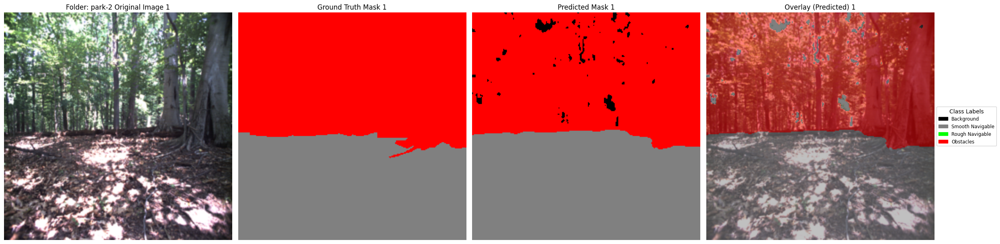

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


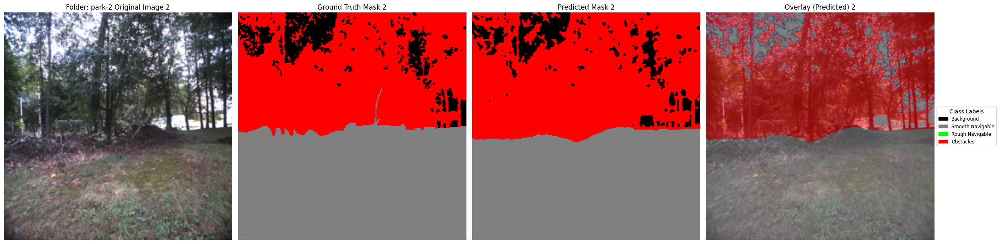

Processing folder: park-8
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


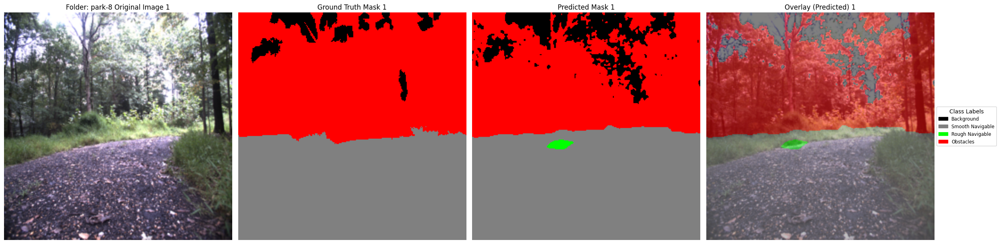

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


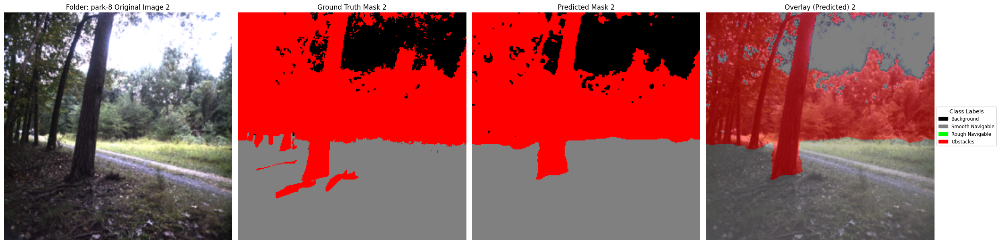

Processing folder: creek
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


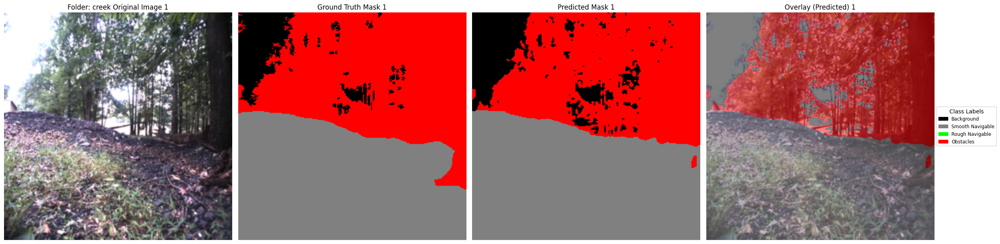

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


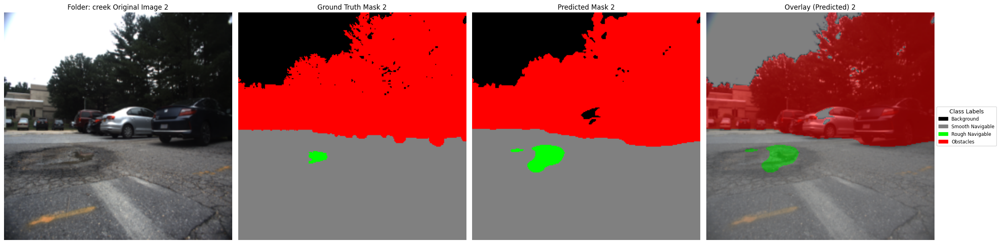

Processing folder: trail
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


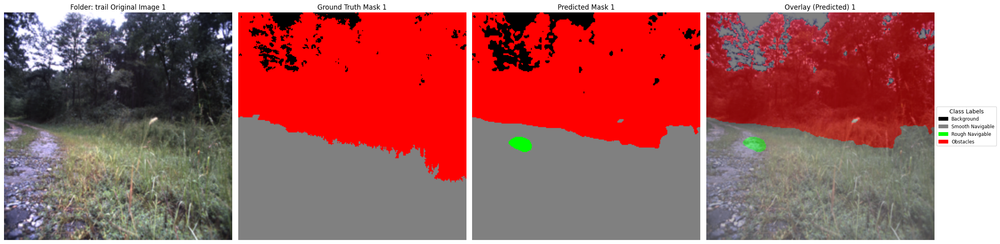

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


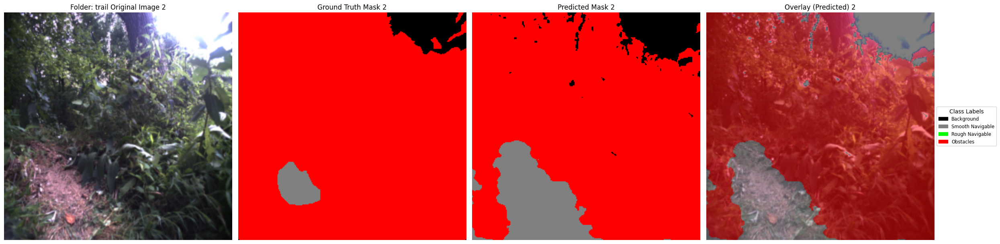

Processing folder: trail-3
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


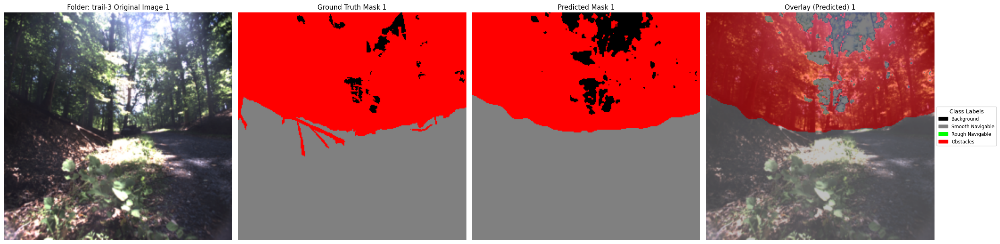

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


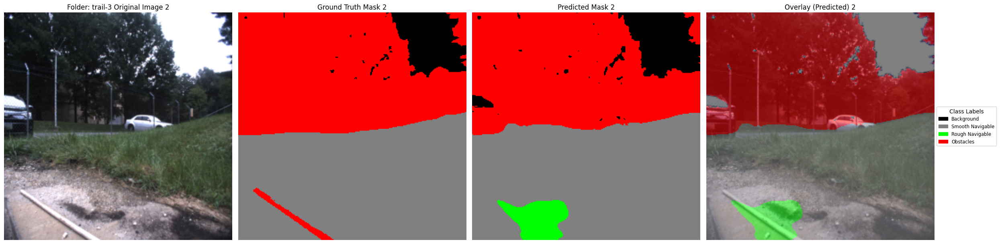

Processing folder: trail-4
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


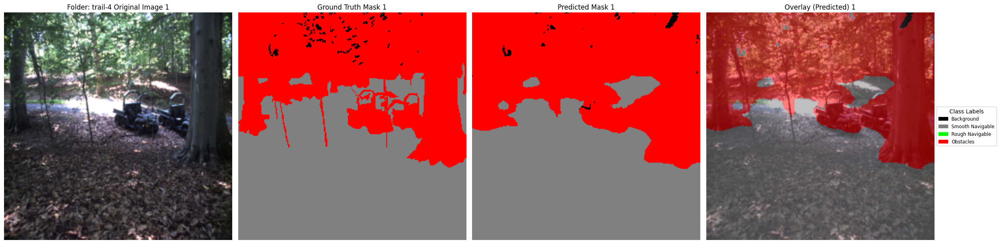

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


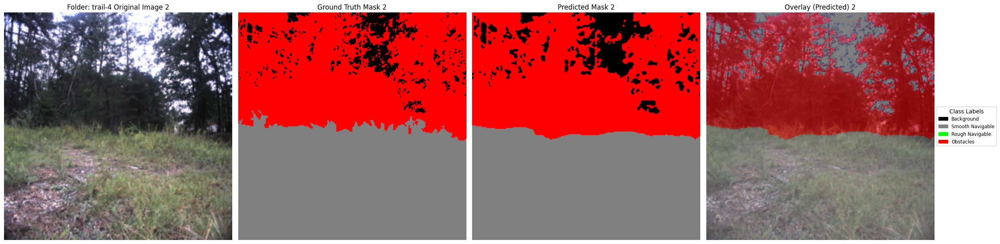

Processing folder: trail-9
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


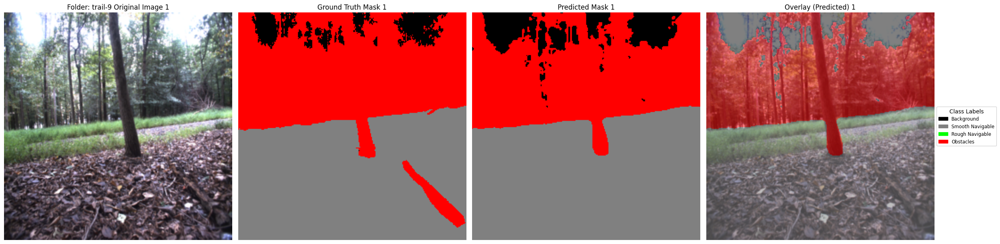

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


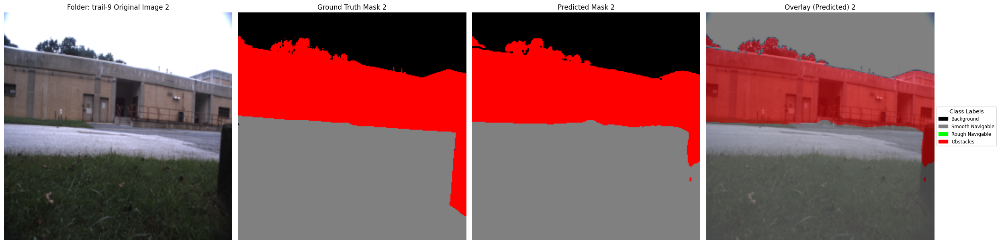

Processing folder: trail-10
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


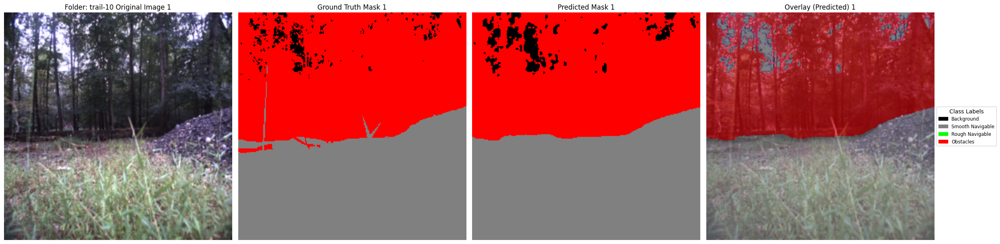

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


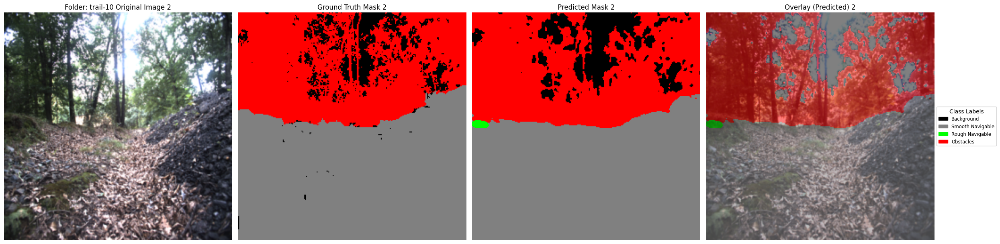

Processing folder: trail-11
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


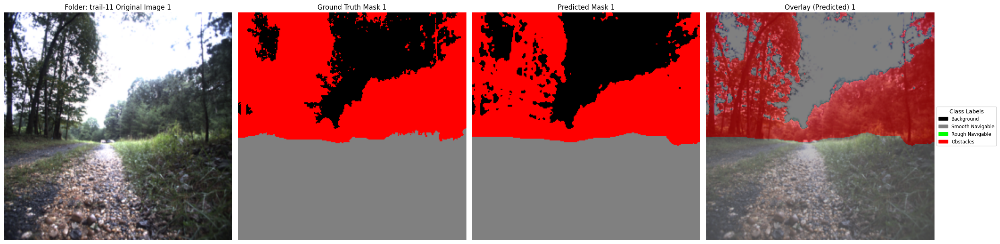

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


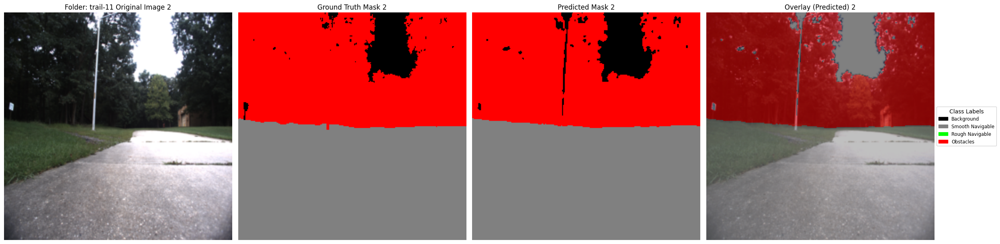

Processing folder: trail-12
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


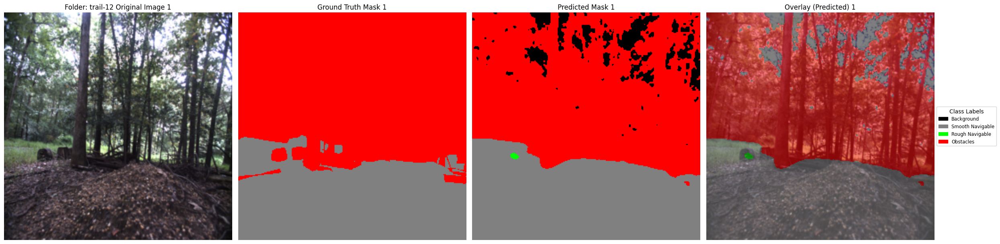

Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


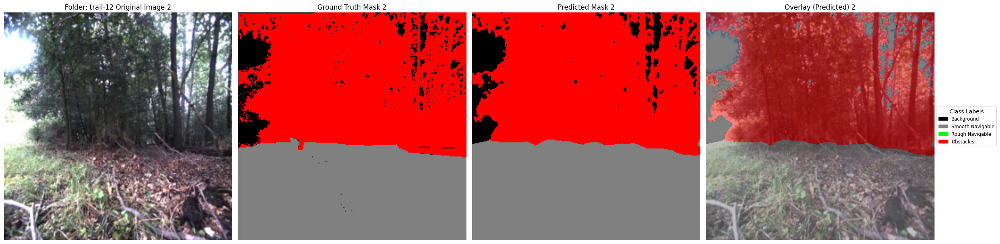

Processing folder: trail-14
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


Processing folder: trail-15
Ground truth visualization saved to: /content/drive/MyDrive/rugd_results/trail-13_groundtruth.png


In [ ]:
import os
base_path = '/content/rugd/rugd/RUGD_frames-with-annotations/RUGD_frames-with-annotations/'

# List of folders
folders = ['park-2', 'park-8', 'creek', 'trail', 'trail-3', 'trail-4', 'trail-9', 'trail-10', 'trail-11',
           'trail-12', 'trail-14', 'trail-15', 'village', 'trail-6', 'trail-5', 'park-1', 'trail-7', 'trail-13']
# Colour map and class map
colour_map = {
    0: (0, 0, 0),       # Background
    1: (128, 128, 128), # Smooth Navigable
    2: (0, 255, 0),     # Rough Navigable
    3: (255, 0, 0)      # Obstacles/Bumpy Navigable
}

class_map = {
    0: "Background",
    1: "Smooth Navigable",
    2: "Rough Navigable",
    3: "Obstacles"
}

# Switch model to evaluation mode
model.eval()

# Visualization and evaluation loop
for folder in folders:
    print(f"Processing folder: {folder}")

    # Assume train_loader is created for each folder
    # Replace this with the actual logic to load data for the folder
    dataset_path = os.path.join(base_path, folder)  # Define `base_path` to the dataset root
    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True) # Replace with your data loader function


    with torch.no_grad():
        for images, masks in train_loader:
            images, masks = images.to(device), masks.to(device)

            # Forward pass
            outputs = model(images)
            predictions = torch.argmax(outputs, dim=1)  # Shape: (batch_size, H, W)

            # Visualize the first 2 samples in the batch
            for i in range(2):  # Change this to sample the desired number of images
                input_image = unnormalize_image(images[i], mean, std)  # Un-normalize the image
                predicted_mask = predictions[i].cpu().numpy()  # Convert predicted mask to NumPy
                original_mask = masks[i].cpu().numpy()  # Convert ground truth mask to NumPy

                # Convert masks to RGB for visualization
                visualized_predicted_mask = convert_to_rgb(predicted_mask, colour_map)
                visualized_original_mask = convert_to_rgb(original_mask, colour_map)

                # Create overlay for predicted mask
                overlay = overlay_mask(input_image, visualized_predicted_mask, alpha=0.5)

                # Display results
                plt.figure(figsize=(25, 6))

                plt.subplot(1, 4, 1)
                plt.title(f"Folder: {folder} Original Image {i+1}")
                plt.imshow(input_image)
                plt.axis('off')

                plt.subplot(1, 4, 2)
                plt.title(f"Ground Truth Mask {i+1}")
                plt.imshow(visualized_original_mask)
                plt.axis('off')

                plt.subplot(1, 4, 3)
                plt.title(f"Predicted Mask {i+1}")
                plt.imshow(visualized_predicted_mask)
                plt.axis('off')

                plt.subplot(1, 4, 4)
                plt.title(f"Overlay (Predicted) {i+1}")
                plt.imshow(overlay)
                plt.axis('off')

                # Add legend for class labels
                legend_patches = generate_legend(class_map, colour_map)
                plt.legend(
                    handles=legend_patches,
                    loc='center left',
                    bbox_to_anchor=(1, 0.5),
                    title="Class Labels",
                    fontsize='small'
                )

                plt.tight_layout()
                if not os.path.exists(save_dir):
                    os.makedirs(save_dir)  # Create the directory if it doesn't exist
                save_path = os.path.join(save_dir, f"{folder_name}_groundtruth.png")
                plt.savefig(save_path, bbox_inches='tight')
                print(f"Ground truth visualization saved to: {save_path}")
                plt.show()

            # Break after visualizing the first batch
            break
